In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as ss
from sklearn.svm import SVC
import matplotlib.pyplot as plt
import pandas_profiling
from string import ascii_letters
from sklearn.impute import KNNImputer
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

In [48]:
pd.set_option('display.max_columns', 50)
train_raw = pd.read_csv('input/CSE7302c_train-1539668060821.csv', na_values='?')
test_raw = pd.read_csv('input/CSE7302c_test-1539668060821.csv', na_values='?')

In [3]:
test_raw.drop(test_raw.index[[29413]], inplace=True)
test_raw.isna().sum()

class                       0
lepton_pT                   0
lepton_eta                  0
lepton_phi                  0
missing_energy_magnitude    0
missing_energy_phi          0
jet1pt                      0
jet1eta                     0
jet1phi                     0
jet1b.tag                   0
jet2pt                      0
jet2eta                     0
jet2phi                     0
jet2b.tag                   0
jet3pt                      0
jet3eta                     0
jet3phi                     0
jet3b.tag                   0
jet4pt                      0
jet4eta                     0
jet4phi                     0
jet4b.tag                   0
m_jj                        0
m_jjj                       0
m_lv                        0
m_jlv                       0
m_bb                        0
m_wbb                       0
m_wwbb                      0
id                          0
dtype: int64

In [4]:
# train size:  68636  observations  30 attributes
# test size:   29414 observations 30 attributes
# We have 68636 and 29414 unique ids in train and test respectively and this nominal data can be removed.
train_data = train_raw.drop('id', axis=1)
test_data = test_raw.drop('id', axis=1)
train_data.head()

,class,lepton_pT,lepton_eta,lepton_phi,missing_energy_magnitude,missing_energy_phi,jet1pt,jet1eta,jet1phi,jet1b.tag,jet2pt,jet2eta,jet2phi,jet2b.tag,jet3pt,jet3eta,jet3phi,jet3b.tag,jet4pt,jet4eta,jet4phi,jet4b.tag,m_jj,m_jjj,m_lv,m_jlv,m_bb,m_wbb,m_wwbb
0,1,0.907542,0.329147,0.359412,1.497970,-0.313010,1.095531,-0.557525,-1.588230,2.173076,0.812581,-0.213642,1.271015,2.214872,0.499994,-1.261432,0.732156,0.000000,0.398701,-1.138930,-0.000819,0.000000,0.302220,0.833048,0.985700,0.978098,0.779732,0.992356,0.798343
1,1,0.798835,1.470639,-1.635975,0.453773,0.425629,1.104875,1.282322,1.381664,0.000000,0.851737,1.540659,-0.819690,2.214872,0.993490,0.356080,-0.208778,2.548224,1.256955,1.128848,0.900461,0.000000,0.909753,1.108330,0.985692,0.951331,0.803252,0.865924,0.780118
2,0,1.344385,-0.876626,0.935913,1.992050,0.882454,1.786066,-1.646778,-0.942383,0.000000,2.423265,-0.676016,0.736159,2.214872,1.298720,-1.430738,-0.364658,0.000000,0.745313,-0.678379,-1.360356,0.000000,0.946652,1.028704,0.998656,0.728281,0.869200,1.026736,0.957904
3,0,1.595839,-0.607811,0.007075,1.818450,-0.111906,0.847550,-0.566437,1.581239,2.173076,0.755421,0.643110,1.426367,0.000000,0.921661,-1.190432,-1.615589,0.000000,0.651114,-0.654227,-1.274345,3.101961,0.823761,0.938191,0.971758,0.789176,0.430553,0.961357,0.957818
4,1,0.409391,-1.884684,-1.027292,1.672452,-1.604598,1.338015,0.055427,0.013466,2.173076,0.509783,-1.038338,0.707862,0.000000,0.746918,-0.358465,-1.646654,0.000000,0.367058,0.069496,1.377130,3.101961,0.869418,1.222083,1.000627,0.545045,0.698653,0.977314,0.828786


In [5]:
cat_cols = train_data.columns[train_data.nunique() <= 5]
print(cat_cols)
num_cols = train_data.columns[train_data.nunique() > 5]
num_cols

Index(['class', 'jet1b.tag', 'jet2b.tag', 'jet3b.tag', 'jet4b.tag'], dtype='object')


Index(['lepton_pT', 'lepton_eta', 'lepton_phi', 'missing_energy_magnitude',
       'missing_energy_phi', 'jet1pt', 'jet1eta', 'jet1phi', 'jet2pt',
       'jet2eta', 'jet2phi', 'jet3pt', 'jet3eta', 'jet3phi', 'jet4pt',
       'jet4eta', 'jet4phi', 'm_jj', 'm_jjj', 'm_lv', 'm_jlv', 'm_bb', 'm_wbb',
       'm_wwbb'],
      dtype='object')

In [6]:
## type casting
train_data[cat_cols] = train_data[cat_cols].astype('category')
test_data[cat_cols] = test_data[cat_cols].astype('category')

In [7]:
# label_encoder = LabelEncoder()
# labelencode4= label_encoder.fit(train_data['jet4b.tag'])
# jet4b_train = pd.DataFrame(labelencode4.transform(train_data['jet4b.tag']), columns=['jet4b.tag'])
# jet4b_test = pd.DataFrame(labelencode4.transform(test_data['jet4b.tag']), columns=['jet4b.tag'])

In [8]:
# cat_cols = cat_cols.drop('class')
# cat_cols = cat_cols.drop('jet4b.tag')
# cat_cols

In [9]:
# train_data = pd.concat([train_data[num_cols], jet4b_train, train_data[cat_cols]], axis=1)
# test_data = pd.concat([test_data[num_cols], jet4b_test, test_data[cat_cols]], axis=1)

In [10]:
profile = pandas_profiling.ProfileReport(train_data, title='Pandas Profiling Report', html={'style':{'full_width':True}})
profile

build report structure: 100%|██████████| 1/1 [00:13<00:00, 13.32s/it]


In [11]:
x_train, y_train = train_data.drop(['jet4b.tag'], axis=1), train_raw['class'].astype('category')
x_test, y_test = test_data.drop(['jet4b.tag'], axis=1), test_raw['class'].astype('category')
print(x_train.shape)
print(x_test.shape)

(68636, 28)
(29413, 28)


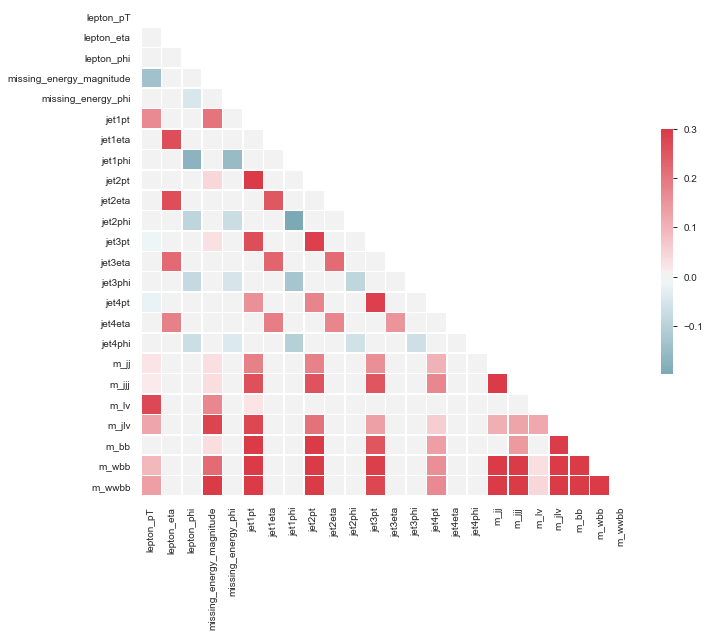

In [12]:
# label_encode_y = label_encoder.fit(y_train)
# encoded_y = pd.DataFrame(label_encode_y.transform(y_train), columns=['target'])
corr_data = pd.concat( [x_train, y_train], axis=1)
corr = corr_data.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [13]:
# svc = SVC()

In [14]:
# y_train_pred = svc.predict(x_train)
# print(f'train accuracy: {accuracy_score(y_train, y_train_pred)}')
# y_test_pred = svc.predict(x_test)
# print(f'test accuracy: {accuracy_score(y_test, y_test_pred)}')

In [15]:
param_grid = {'criterion':["gini","entropy"],'max_depth':[None,15,20,25],'min_samples_split':[2,10,20,30]}
dt_cv_model = DecisionTreeClassifier()
gs_object = GridSearchCV(dt_cv_model,param_grid=param_grid,verbose=10,n_jobs=-1, cv=3)
gs_object.fit(x_train, y_train)

Fitting 3 folds for each of 32 candidates, totalling 96 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done  48 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done  61 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done  83 out of  96 | elapsed:    6.7s remaining:    1.1s
[Parallel(n_jobs=-1)]: Done  93 out of  96 | elapsed:    7.3s remaining:    0.2s
[Parallel(n_jobs=-1)]: Done  96 out of  96 | elapsed:    7.3s finished


GridSearchCV(cv=3, error_score=nan,
             estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features=None,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              presort='deprecated',
                                              random_state=None,
                                              splitter='best'),
             iid='deprecated', n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                     

In [16]:
gs_object.get_params()

{'cv': 3,
 'error_score': nan,
 'estimator__ccp_alpha': 0.0,
 'estimator__class_weight': None,
 'estimator__criterion': 'gini',
 'estimator__max_depth': None,
 'estimator__max_features': None,
 'estimator__max_leaf_nodes': None,
 'estimator__min_impurity_decrease': 0.0,
 'estimator__min_impurity_split': None,
 'estimator__min_samples_leaf': 1,
 'estimator__min_samples_split': 2,
 'estimator__min_weight_fraction_leaf': 0.0,
 'estimator__presort': 'deprecated',
 'estimator__random_state': None,
 'estimator__splitter': 'best',
 'estimator': DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                        max_depth=None, max_features=None, max_leaf_nodes=None,
                        min_impurity_decrease=0.0, min_impurity_split=None,
                        min_samples_leaf=1, min_samples_split=2,
                        min_weight_fraction_leaf=0.0, presort='deprecated',
                        random_state=None, splitter='best'),
 'iid': 'deprecated',
 

In [17]:
y_train_pred = gs_object.predict(x_train)
print(f'train accuracy: {accuracy_score(y_train, y_train_pred)}')
y_test_pred = gs_object.predict(x_test)
print(f'test accuracy: {accuracy_score(y_test, y_test_pred)}')

train accuracy: 1.0
test accuracy: 1.0


In [55]:
prediction = pd.DataFrame(y_test_pred, columns=['predictions'])
id = pd.DataFrame(test_raw['id'], columns=['id'])
actual = test_raw['class']
actual = np.array(actual).reshape(-1,1)
actual = pd.DataFrame(actual, columns=['class'])
output = pd.concat([id, actual, prediction], axis=1).to_csv('output/prediction_3.csv', index=None)